In [1]:
import os
import datetime
import numpy as np
import pandas as pd
import sqlalchemy as sa
import altair as alt
from altair.expr import datum, if_

In [2]:
# we need to run this line to use Altair in a Jupyter notebook
alt.renderers.enable('notebook')

RendererRegistry.enable('notebook')

In [3]:
# Altair raises a MaxRowsError exception when passing a dataset with more than 5000 rows.
ALTAIR_LIMIT = 5000
# The limit of 5000 rows can be disabled with this line
# https://altair-viz.github.io/user_guide/faq.html#maxrowserror-how-can-i-plot-large-datasets
alt.data_transformers.enable('default', max_rows=None)

DataTransformerRegistry.enable('default')

In [7]:
ROOT = os.path.abspath(os.path.pardir)
DB_NAME = 'TSA.db'
DB_PATH = os.path.abspath(os.path.join(ROOT, DB_NAME))
DB_PATH

'/home/giacomo/repos/reddit-dataviz-battle-2018-08/TSA.db'

In [8]:
engine = sa.create_engine(f"sqlite:///{DB_PATH}")

## Data

In [9]:
sql = '''
SELECT * FROM claims AS c
LIMIT 100
'''

In [10]:
df = pd.read_sql(sql, con=engine)
print(f"Shape: {df.shape}")
df.sample(n=5)

OperationalError: (sqlite3.OperationalError) no such table: claims [SQL: '\nSELECT * FROM claims AS c\n'] (Background on this error at: http://sqlalche.me/e/e3q8)

In [11]:
# for queries with a lot of results, read in chunks
# chunks = pd.read_sql(sql, con=engine, chunksize=1000)
# for df in chunks:
#     print(f"Shape: {df.shape}")
#     print(df.sample(n=5))

The only quantitative variable is `close_amount`.

In [12]:
# df.describe(include='all')  # include all types of variables
df.describe()

,claim_amount,claim_number,close_amount
count,4.700300e+04,1.068430e+05,92212.000000
mean,6.385020e+07,2.010447e+12,71.435133
std,1.383753e+10,2.626244e+09,327.518717
min,0.000000e+00,2.004083e+12,0.000000
25%,7.000000e+01,2.008062e+12,0.000000
50%,2.000000e+02,2.010073e+12,0.000000
75%,5.270000e+02,2.013021e+12,32.100000
max,3.000000e+12,2.016020e+12,25483.440000


Many occurrences of `close_amount` are `0`. Actually, it's the majority: denying a claim is the most frequent disposition.

In [9]:
df_zero = df[df['close_amount'] == 0]
df_zero.shape

(69057, 10)

It makes sense. Whenever the `Disposition` is to `Deny` the claim, `Claim Amount` is `0`.

In [10]:
df_zero.disposition.unique()

array(['Deny', None], dtype=object)

In [11]:
df_zero.head()

,date_received,incident_date,airport_code,airport_name,airline_name,claim_type,claim_site,item,close_amount,disposition
0,2014-01-13,2012-12-21 00:00:00,HPN,"Westchester County, White Plains",USAir,Personal Injury,Checked Baggage,Audio/Video; Jewelry & Watches,0.0,Deny
1,2014-01-13,2012-12-21 00:00:00,HPN,"Westchester County, White Plains",USAir,Personal Injury,Checked Baggage,Audio/Video; Jewelry & Watches,0.0,Deny
2,2014-07-17,2014-06-30 18:38:00,MCO,Orlando International Airport,Delta Air Lines,Property Damage,Checked Baggage,None,0.0,Deny
4,2014-01-07,2014-01-02 00:00:00,IAD,Washington Dulles International,UAL,Property Damage,Checked Baggage,Baggage/Cases/Purses,0.0,Deny
5,2014-01-09,2014-01-07 00:00:00,SAT,San Antonio International,Southwest Airlines,Property Damage,Checked Baggage,Computer & Accessories,0.0,Deny


There seem to be a few very high values. We could say that if a value if `Claim Amount` is higher than 99.9% of the values, it's an *outlier*.

In [12]:
ca = df['close_amount']
outlier_threshold = ca.quantile(.999)
outlier_threshold

3342.544000000111

In [13]:
df_outliers = df[ca >= ca.quantile(.999)]
df_outliers.shape

(104, 10)

In [14]:
df_outliers.head()

,date_received,incident_date,airport_code,airport_name,airline_name,claim_type,claim_site,item,close_amount,disposition
94,2014-04-24,2013-08-02 00:00:00,ZZX,Non TSA Airport (motor vehicle),None,Personal Injury,Motor Vehicle,None,20000.00,Settle
921,2014-02-03,2013-09-09 00:00:00,SMF,Sacramento International Airport,None,Property Damage,Checkpoint,Other,6183.36,Approve in Full
4371,2014-06-27,2013-12-01 20:15:00,FWA,Ft. Wayne Municipal- Baer Field,None,Property Damage,Checkpoint,None,25483.44,Settle
8659,2014-12-15,2012-12-13 00:00:00,ZZX,Non TSA Airport (motor vehicle),None,Motor Vehicle,Motor Vehicle,None,5158.05,Approve in Full
11667,2015-02-06,2013-02-28 00:00:00,HNL,Honolulu International Airport,Delta Air Lines,Personal Injury,Checkpoint,None,5000.00,Settle


I am not sure what `ZZX` is. A motor vehicle? It's not an airport code...

Anyway, there are a few of them...

In [15]:
df_zzx = df[df['airport_code'] == 'ZZX']
df_zzx.shape

(321, 10)

...and they have a much higher `close_amount`.

In [16]:
df_zzx.describe()

,close_amount
count,177.000000
mean,1761.223559
std,2965.045699
min,0.000000
25%,450.000000
50%,930.180000
75%,1961.560000
max,20000.000000


In [17]:
df_not_zzx = df[df['airport_code'] != 'ZZX']
df_not_zzx.describe()

,close_amount
count,103756.000000
mean,71.565177
std,304.342894
min,0.000000
25%,0.000000
50%,0.000000
75%,40.000000
max,25483.440000


Let's try to analyze the `close_amount` distribution in a range of values between `0` and `outlier_threshold` (both excluded).

In [18]:
df_in_range = df[(ca > 0) & (ca < outlier_threshold)]
df_in_range.shape

(34772, 10)

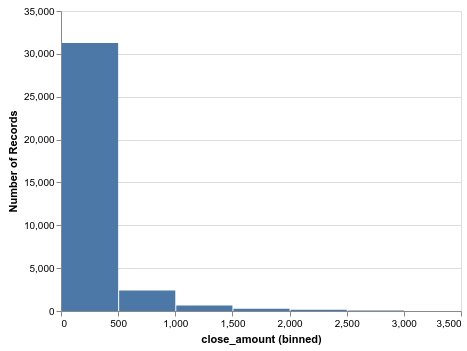

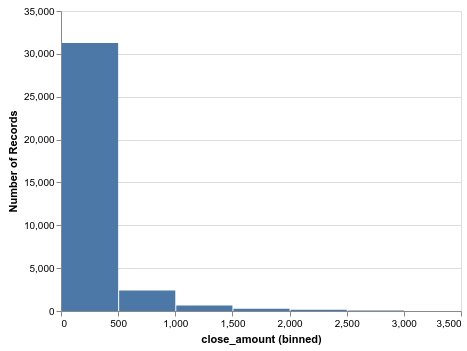

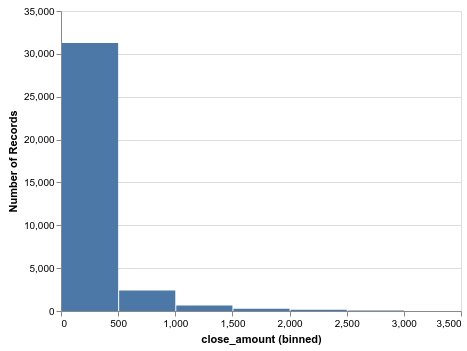

In [19]:
alt.Chart(df_in_range).mark_bar()\
.encode(
    x=alt.X("close_amount", bin=True),
    y='count()'
)

When creating a histogram, it's important to try different bin sizes.

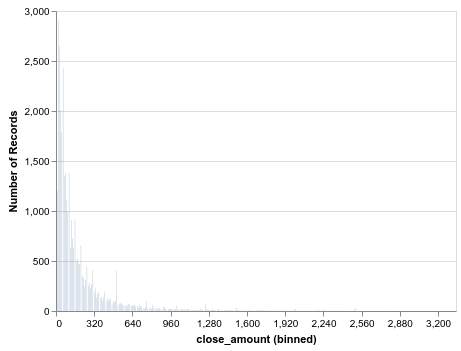

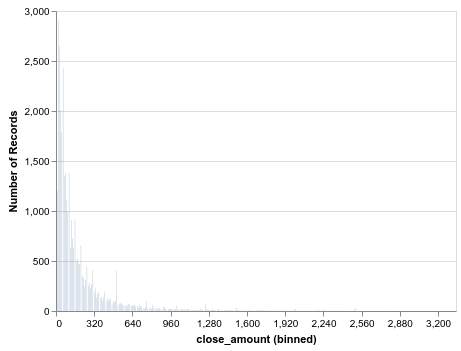

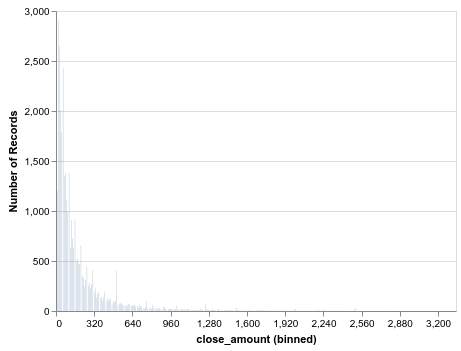

In [20]:
alt.Chart(df_in_range).mark_bar()\
.encode(
    x=alt.X("close_amount", bin=alt.BinParams(step=10, nice=True)),
    y='count()',
)

A (relatively) small number of high values cause the histogram to spread too much.

Let's try to plot the records where `close_amount` is between 0 and the 95th percentile.

In [21]:
ca = df['close_amount']
df95 = df[(ca > 0) & (ca <= ca.quantile(.95))]
df95.shape

(29679, 10)

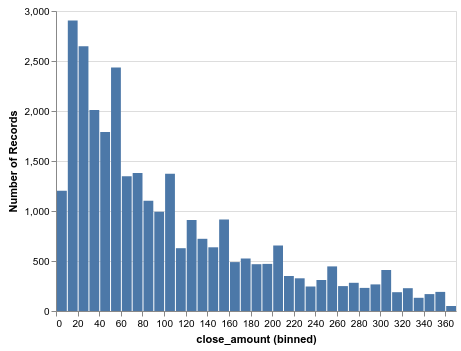

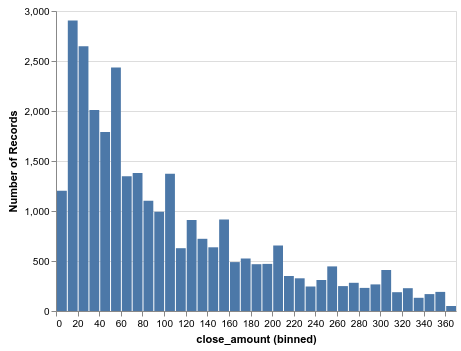

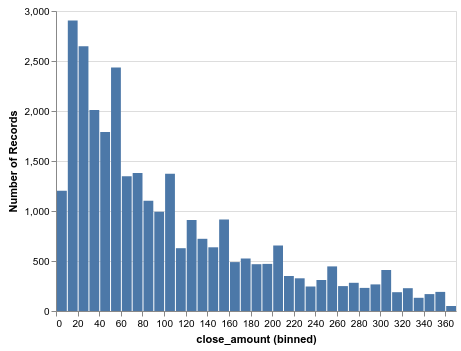

In [23]:
chart = alt.Chart(df95).mark_bar()\
.encode(
    x=alt.X('close_amount', bin=alt.BinParams(step=10, nice=True)),
    y='count()',
)
chart

In [24]:
chart.save('histogram.html')

In [23]:
df.shape

(124367, 10)

In [24]:
df_not_na = df.dropna(subset=['claim_type', 'close_amount', 'disposition'])
df_not_na.shape

(101960, 10)

In [25]:
claim_types = df_not_na['claim_type'].unique().tolist()

In [ ]:
# Q is a shorthand to declare a Quantitative datatype in Altair
alt.Chart(df_not_na).mark_bar()\
.encode(
    x=alt.X('count(*):Q', axis=alt.Axis(title='Number of closed claims')),
    y=alt.Y('claim_type', sort=claim_types, axis=alt.Axis(title=''))
)\
.properties(
    title='Number of closed claims by Claim Type',
    width=600,
    height=400
)

In [ ]:
alt.Chart(df).mark_bar(stroke='transparent')\
.encode(
    x=alt.X('disposition', axis=alt.Axis(title='')),
    y=alt.Y('count(*):Q', axis=alt.Axis(title='Closed claims', grid=True)),    
    color=alt.Color('claim_type', title='Type of claim'),
    column=alt.Column('claim_type', title='Num. of closed claims by claim type and disposition'),
).configure_view(
    stroke='transparent'
).configure_axis(
    domainWidth=0.8,
    # ticks=False
).properties(width=100, height=200)

In [ ]:
alt.Chart(df_not_na).mark_bar(stroke='transparent')\
.encode(
    x=alt.X('disposition', axis=alt.Axis(title='')),
    y=alt.Y('count(*):Q', axis=alt.Axis(title='Closed claims', grid=True)),    
    color=alt.Color('claim_type', title='Type of claim'),
    column=alt.Column('claim_type', title='Num. of closed claims by claim type and disposition'),
).configure_view(
    stroke='transparent'
).configure_axis(
    domainWidth=0.8,
    # ticks=False
).properties(width=100, height=200)

[MPCECA](https://www.law.cornell.edu/cfr/text/29/15.200)

In [ ]:
# line = alt.Chart(df_low).mark_line().encode(
#     x=alt.X('Date Received', axis=alt.Axis(title='ddd')),
#     y='Close Amount',
#     color='Claim Type'
# ).properties(
#     width=600,
#     title="Daily closing prices with their aggregate prices"
# ).interactive(bind_y=False)

# rule = alt.Chart(df_low).mark_rule().encode(
#     alt.Y('median(Close Amount):Q'),
#     size=alt.value(2),
#     color='Claim Type'
# )

# line + rule

In [ ]:
def make_years_df(df, date_col, other_col, agg):
    assert date_col in ['date_received', 'incident_date']
    assert agg in ['count', 'sum']
    
    df_time_indexed = df.set_index(df[date_col])
    dg = df_time_indexed[[date_col, other_col]]\
      .groupby(pd.Grouper(key=date_col, freq='1D'))\
      .agg(agg)
    
    ddf = dg.reset_index()
    ddf.rename(columns={date_col: 'date', other_col: 'value'}, inplace=True)
    ddf['type'] = other_col
    return ddf

In [ ]:
date_col = 'date_received'
df_disposition = make_years_df(df, date_col, 'disposition', agg='count')
df_claim_type = make_years_df(df, date_col, 'claim_type', agg='count')
df_close_amount = make_years_df(df, date_col, 'close_amount', agg='sum')
n = 3
pd.concat([df_disposition.head(n), df_claim_type.head(n), df_close_amount.head(n)])

In [ ]:
def make_final_df(dataframes):
    """Group a DataFrame by time period.
    
    See Also:
        https://docs.python.org/2/library/time.html
    """
    date_col = 'date'
    df_concatenated = pd.concat(dataframes, axis=0)
    df_time_indexed = df_concatenated.set_index(df_concatenated[date_col])
    df_time_indexed.drop(columns=['date'], inplace=True)
    
    df_time_indexed['year'] = df_time_indexed.index.strftime('%Y')
    df_time_indexed['month_human'] = df_time_indexed.index.strftime('%b')
    df_time_indexed['month_number'] = df_time_indexed.index.strftime('%m')
    df_time_indexed['day_of_year'] = df_time_indexed.index.strftime('%j')
    df_time_indexed['weekday_human'] = df_time_indexed.index.strftime('%a')
    df_time_indexed['weekday_number'] = df_time_indexed.index.strftime('%w')
    
    df = df_time_indexed.reset_index().drop(columns=['date'])
    
    def assign_type(input_type):
        if input_type == 'claim_type':
            output_type = 'claim'
        else:
            output_type = input_type
            
        return output_type
    
    df['type'] = [assign_type(r['type']) for i,r in df.iterrows()]
    return df

In [ ]:
df_final = make_final_df([df_disposition, df_claim_type, df_close_amount])
print(df_final.shape)
df_final.describe()

In [ ]:
weekdays = ['Sun', 'Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat']
months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
years = df_final.year.unique().tolist()

In [ ]:
alt.Chart(df_final).mark_bar(stroke='transparent')\
.encode(
    x=alt.X('type', axis=alt.Axis(title='')),
    y=alt.Y('value', axis=alt.Axis(title='', grid=True)),
    color=alt.Color('type', title='Type'),
    column=alt.Column('weekday_number', title='Claims and dispositions across the week (0=Sunday)'),
)\
.transform_filter(datum.type != 'close_amount')\
.configure_view(
    stroke='transparent'
).configure_axisX(
    domainWidth=0.8
).properties(width=100, height=200)

In [ ]:
def make_hcc(row_of_charts):
    hconcat = [chart for chart in row_of_charts]
    hcc = alt.HConcatChart(hconcat=hconcat)
    return hcc

In [ ]:
def facet_wrap(charts, charts_per_row):
    rows_of_charts = [charts[i:i+charts_per_row] for i in range(0, len(charts), charts_per_row)]
    vconcat = [make_hcc(r) for r in rows_of_charts]    
    vcc = alt.VConcatChart(vconcat=vconcat).configure_axisX(grid=False).configure_axisY(grid=True)
    return vcc

In [ ]:
def make_chart(base_chart, year):
    chart = base_chart\
      .transform_filter(datum.year == year)\
      .properties(width=150, height=150, title=year)
    return chart

In [ ]:
grouped_disposition = df_final[df_final['type'] == 'disposition']\
  .groupby(by=['year', 'month_human'])[['value']]\
  .sum()

grouped_claim = df_final[df_final['type'] == 'claim']\
  .groupby(by=['year', 'month_human'])[['value']]\
  .sum()

bottom = 0
top = max([grouped_disposition.value.max(), grouped_claim.value.max()])
top

In [ ]:
df_final.sample(n=5)

In [ ]:
base_chart = alt.Chart(df_final).mark_line()\
.encode(
    x=alt.X('month_human', sort=months, axis=alt.Axis(title='')),
    y=alt.Y('sum(value):Q', axis=alt.Axis(title=''), scale=alt.Scale(domain=(bottom, top))),
    color=alt.Color('type', title='Type'),
    order='month_number'
)\
.transform_filter(datum.type != 'close_amount')

In [ ]:
charts = [make_chart(base_chart, year) for year in years]
len(charts)

In [ ]:
# base_chart = alt.Chart(df_final).mark_line()\
# .encode(
#     x=alt.X('month_human', sort=months, axis=alt.Axis(title='')),
#     y=alt.Y('sum(value):Q', axis=alt.Axis(title='')),
#     color=alt.Color('type', title='Type'),
#     order='month_number'
# )\
# .transform_filter(datum.year == '2010')\
# .transform_filter(datum.type != 'close_amount')
# base_chart

In [ ]:
compound_chart = facet_wrap(charts, charts_per_row=4)
compound_chart.properties(title='Number of claims vs. Number of dispositions over time')

In [ ]:
grouped_close_amount = df_final[df_final['type'] == 'close_amount']\
  .groupby(by=['year', 'month_human'])[['value']]\
  .sum()

top = grouped_close_amount.value.max()
bottom = 0

In [ ]:
base_chart2 = alt.Chart(df_final).mark_line(clip=True)\
.encode(
    x=alt.X('month_human', sort=months, axis=alt.Axis(title='')),
    y=alt.Y('sum(value):Q', axis=alt.Axis(title=''), scale=alt.Scale(domain=(bottom, top))),
    color=alt.Color('type', title='Type', legend=None),
    order='month_number'
)\
.transform_filter(datum.type == 'close_amount')

In [ ]:
charts = [make_chart(base_chart2, year) for year in years]
compound_chart = facet_wrap(charts, charts_per_row=4)
compound_chart.properties(title='Money paid by TSA for closed claims each year')

In [ ]:
period = 'month_number'
period_human = 'month'
line = alt.Chart(df_final).mark_line().encode(
    x=period,
    y=alt.Y('mean(value):Q', axis=alt.Axis(title='', format='$.1s'))
).transform_filter(datum.type == 'close_amount')

confidence_interval = alt.Chart(df_final).mark_area(opacity=0.3).encode(
    x=period,
    y=alt.Y('ci0(value)'),
    y2='ci1(value)'
).transform_filter(datum.type == 'close_amount')

chart = confidence_interval + line
chart.properties(title=f"Close Amount, paid by the TSA each {period_human}", width=200)

In [ ]:
period = 'weekday_number'
period_human = 'weekday'
line = alt.Chart(df_final).mark_line().encode(
    x=period,
    y=alt.Y('mean(value):Q', axis=alt.Axis(title='', format='$.1s'))
).transform_filter(datum.type == 'close_amount')

confidence_interval = alt.Chart(df_final).mark_area(opacity=0.3).encode(
    x=period,
    y=alt.Y('ci0(value)'),
    y2='ci1(value)'
).transform_filter(datum.type == 'close_amount')

chart = confidence_interval + line
chart.properties(title=f"Close Amount, paid by the TSA each {period_human}", width=200)